# Сегментация космических объектов 




## Загрузка данных

Набор данных - [Final_dataset](https://drive.google.com/drive/u/0/folders/1Q1wR9aBFCyeFEYa3wwyXNu9wk_fZdzUm)

→ Данный датасет состоит из 3 116 изображений и масок как синтезированных, так и реальных изображений спутников и космических станций (размер масок — 1 280x720).

→ Каждый космический аппарат разделён максимум на три части, включая корпус, солнечную панель и антенну, помеченные, соответственно, тремя цветами — зелёным, красным и синим.

→ В папке images находятся изображения, в папке mask — маски объектов.

→ Изображение с индексом 0-1002 имеет точную маску, а изображения с индексом 1003-3116 — грубую маску.

→ Наборы данных разделены на две части: обучающую выборку, включая 403 точные маски из индексов 0-402, и 2 114 грубых масок из индекса 1003-3116.

→ Набор данных val включает 600 изображений с точной маской, проиндексированных от 403 до 1002.

In [8]:
images_path = 'Final_dataset/images/'
mask_path = 'Final_dataset/mask/'
all_bbox = 'Final_dataset/all_bbox.txt'

## Импортируем нужные библиотеки

In [3]:
import os
import pandas as pd
import json
from PIL import Image

import albumentations as A
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as patches
import numpy as np
import pytorch_lightning as pl
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchmetrics

from albumentations.pytorch.transforms import ToTensorV2
from pytorch_lightning.callbacks import (
    EarlyStopping,
    LearningRateMonitor,
    ModelCheckpoint,
)
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, Dataset
from tqdm.auto import tqdm

c:\Users\alex_\AppData\Local\Programs\Python\Python312\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Знакомство с данными

In [5]:
display(len(os.listdir('Final_dataset/images/train')))
display(len(os.listdir('Final_dataset/images/val')))
display(len(os.listdir('Final_dataset/mask/train')))
display(len(os.listdir('Final_dataset/mask/val')))

2518

601

2517

600

In [6]:
display(len(os.listdir('Final_dataset/mask/val'))+len(os.listdir('Final_dataset/mask/train')))

3117

In [19]:
with open(all_bbox, 'r') as f:
    dct = json.load(f)

all_bbox_df = pd.DataFrame.from_dict(dct, orient='index')
all_bbox_df

,0,1,2,3,4,5,6,7,8,9,10
1003,"[1142.0, 547.0, 296.0, 135.0]",None,None,None,None,None,None,None,None,None,None
1004,"[728.0, 198.0, 542.0, 59.0]","[212.0, 305.0, 0.0, 118.0]","[1279.0, 437.0, 768.0, 85.0]",None,None,None,None,None,None,None,None
1005,"[1214.0, 582.0, 322.0, 32.0]",None,None,None,None,None,None,None,None,None,None
1006,"[1268.0, 685.0, 77.0, 30.0]",None,None,None,None,None,None,None,None,None,None
1007,"[1194.0, 602.0, 107.0, 90.0]",None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...
998,"[1194, 591, 44, 155]",None,None,None,None,None,None,None,None,None,None
999,"[705, 631, 1, 36]",None,None,None,None,None,None,None,None,None,None
1000,"[894, 568, 483, 18]",None,None,None,None,None,None,None,None,None,None
1001,"[1197, 631, 378, 265]",None,None,None,None,None,None,None,None,None,None


In [31]:
all_bbox_df[all_bbox_df[1].notna()]

,0,1,2,3,4,5,6,7,8,9,10
1004,"[728.0, 198.0, 542.0, 59.0]","[212.0, 305.0, 0.0, 118.0]","[1279.0, 437.0, 768.0, 85.0]",None,None,None,None,None,None,None,None
1014,"[1057.0, 268.0, 874.0, 111.0]","[783.0, 305.0, 578.0, 78.0]","[342.0, 719.0, 97.0, 319.0]","[1279.0, 669.0, 1024.0, 191.0]",None,None,None,None,None,None,None
1020,"[287.0, 394.0, 144.0, 312.0]","[480.0, 306.0, 251.0, 172.0]","[280.0, 203.0, 105.0, 78.0]","[1220.0, 348.0, 788.0, 139.0]","[798.0, 458.0, 456.0, 165.0]",None,None,None,None,None,None
1021,"[1017.0, 140.0, 890.0, 88.0]","[600.0, 197.0, 291.0, 68.0]","[1120.0, 562.0, 223.0, 214.0]",None,None,None,None,None,None,None,None
1035,"[638.0, 244.0, 104.0, 1.0]","[639.0, 719.0, 0.0, 0.0]",None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...
954,"[623, 513, 327, 256]","[989, 393, 761, 206]",None,None,None,None,None,None,None,None,None
956,"[1278, 580, 717, 217]","[551, 314, 340, 157]","[181, 226, 66, 138]",None,None,None,None,None,None,None,None
958,"[483, 174, 403, 151]","[415, 248, 322, 199]","[321, 368, 72, 275]","[559, 655, 286, 466]","[257, 601, 35, 409]","[1244, 523, 863, 304]","[796, 575, 534, 328]",None,None,None,None
961,"[701, 347, 612, 278]","[422, 437, 184, 237]","[1136, 652, 642, 233]",None,None,None,None,None,None,None,None


Видим что в представленном датасете присутствует 360 изображений, на которых изображено более 1 космического аппарата.

### Пример изображения с точной маской

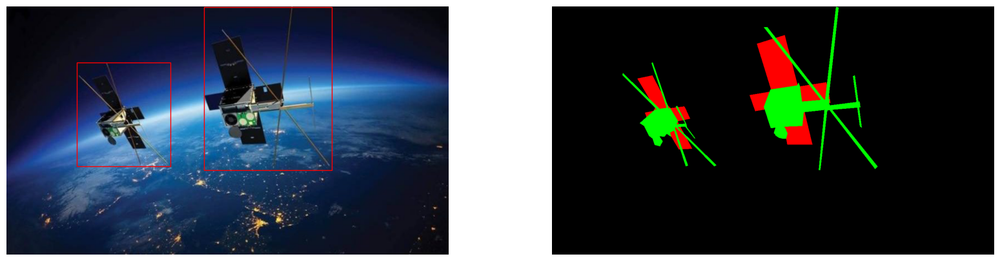

In [60]:
img1 = mpimg.imread('Final_dataset/images/train/img_resize_3.png')
img2 = mpimg.imread('Final_dataset/mask/train/img_resize_3_mask.png')

fig, ax = plt.subplots(1, 2, figsize=(20, 5))
ax[0].imshow(img1)
ax[0].axis('off')
xmin, ymin, xmax, ymax = all_bbox_df.loc['3'][0]
rect = patches.Rectangle((xmin, ymin), (xmax-xmin), (ymax-ymin), linewidth=1, edgecolor='r', facecolor='none')
ax[0].add_patch(rect)
xmin, ymin, xmax, ymax = all_bbox_df.loc['3'][1]
rect = patches.Rectangle((xmin, ymin), (xmax-xmin), (ymax-ymin), linewidth=1, edgecolor='r', facecolor='none')
ax[0].add_patch(rect)

ax[1].imshow(img2)
ax[1].axis('off')

plt.show()

### Пример изображения с грубой маской

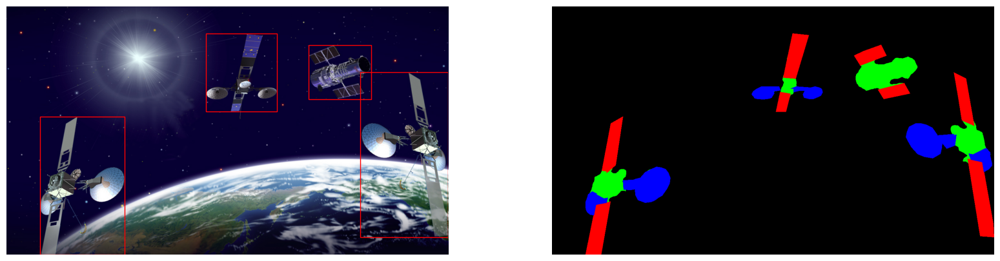

In [63]:
img1 = mpimg.imread('Final_dataset/images/train/img_resize_1014.png')
img2 = mpimg.imread('Final_dataset/mask/train/img_resize_1014_mask.png')

fig, ax = plt.subplots(1, 2, figsize=(20, 5))
ax[0].imshow(img1)
ax[0].axis('off')
xmin, ymin, xmax, ymax = all_bbox_df.loc['1014'][0]
rect = patches.Rectangle((xmin, ymin), (xmax-xmin), (ymax-ymin), linewidth=1, edgecolor='r', facecolor='none')
ax[0].add_patch(rect)
xmin, ymin, xmax, ymax = all_bbox_df.loc['1014'][1]
rect = patches.Rectangle((xmin, ymin), (xmax-xmin), (ymax-ymin), linewidth=1, edgecolor='r', facecolor='none')
ax[0].add_patch(rect)
xmin, ymin, xmax, ymax = all_bbox_df.loc['1014'][2]
rect = patches.Rectangle((xmin, ymin), (xmax-xmin), (ymax-ymin), linewidth=1, edgecolor='r', facecolor='none')
ax[0].add_patch(rect)
xmin, ymin, xmax, ymax = all_bbox_df.loc['1014'][3]
rect = patches.Rectangle((xmin, ymin), (xmax-xmin), (ymax-ymin), linewidth=1, edgecolor='r', facecolor='none')
ax[0].add_patch(rect)

ax[1].imshow(img2)
ax[1].axis('off')

plt.show()

Можно заметить что при грубой маске игнорируются мелкие детали, антенны 

## Преобразование масок в аннотации YOLO

**Пример формата аннотации:** 
- 8 0.575 0.381474 0.5875 0.377771 0.599996 0.355556 0.602079 0.311111 0.595833 0.300007 0.566667 0.300007 0.564583 0.314822 0.554167 0.314822 0.55 0.325933 0.535417 0.329637 ... Xn Yn

***Где первое число кодирует класс ~~, следующие четыре кодируют информацию о ограничивающей рамке~~. Остальные числа кодируют границу объекта, который мы пытаемся сегментировать. Начиная с 6-го числа, у нас есть разделенные пробелом координаты x-y для каждой точки на границе объекта для маски сегментации.***

In [35]:
def mask_to_annotation(img_path):
    mask = cv2.imread(img_path, cv2.IMREAD_COLOR)
    _, mask = cv2.threshold(mask, 128, 255, cv2.THRESH_BINARY)

    # Создадим бинаризованные маски для каждого цвета
    lower_green = np.array([0, 100, 0])
    upper_green = np.array([100, 255, 100])
    green_mask = cv2.inRange(mask, lower_green, upper_green)

    lower_red = np.array([0, 0, 100])
    upper_red = np.array([100, 100, 255])
    red_mask = cv2.inRange(mask, lower_red, upper_red)

    lower_blue = np.array([100, 0, 0])
    upper_blue = np.array([255, 100, 100])
    blue_mask = cv2.inRange(mask, lower_blue, upper_blue)

    # В масках были обнаружены шумы, необходимо их устранить
    kernel = np.ones((3, 3), np.uint8)  # Ядро размером 3x3
    green_mask = cv2.erode(green_mask, kernel, iterations=1)
    green_mask = cv2.dilate(green_mask, kernel, iterations=1)

    blue_mask = cv2.erode(blue_mask, kernel, iterations=1)
    blue_mask = cv2.dilate(blue_mask, kernel, iterations=1)

    red_mask = cv2.erode(red_mask, kernel, iterations=1)
    red_mask = cv2.dilate(red_mask, kernel, iterations=1)

    # Найдем контуры объектов в каждой маске
    green_contours, _ = cv2.findContours(green_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    red_contours, _ = cv2.findContours(red_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    blue_contours, _ = cv2.findContours(blue_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    with open('Final_dataset/annotations/' + img_path.split('/')[-2] + '/img_resize_' + img_path.split('_')[-2] + '.txt', 'w') as f:
        for i, contour in enumerate(green_contours):
            # Извлекаем координаты контура
            epsilon = 0.001 * cv2.arcLength(contour, True)
            approx = cv2.approxPolyDP(contour, epsilon, True)
            coords = approx.reshape(-1, 2).tolist()

            # Контур должен начинаться и заканчиваться в одной точке
            coords.append(coords[0])

            # Нормализуем координаты точек контура
            coords = np.array(coords) / [mask.shape[1], mask.shape[0]]

            # Записываем координаты в txt-файл
            f.write(f'{0} ')  # Индекс класса (зеленый)
            x, y, w, h = cv2.boundingRect(contour)
            #f.write(f'{x / mask.shape[1]} {y / mask.shape[0]} {(x + w) / mask.shape[1]} {(y + h) / mask.shape[0]} ')  # Ограничивающая рамка
            f.write(' '.join(map(str, np.array(coords).flatten())) + '\n')  # Координаты точек контура

        # Повторяем для остальных цветов
        for i, contour in enumerate(red_contours):

            epsilon = 0.001 * cv2.arcLength(contour, True)
            approx = cv2.approxPolyDP(contour, epsilon, True)
            coords = approx.reshape(-1, 2).tolist()

            coords.append(coords[0])

            coords = np.array(coords) / [mask.shape[1], mask.shape[0]]

            f.write(f'{1} ')  # Индекс класса (красный)
            x, y, w, h = cv2.boundingRect(contour)
            #f.write(f'{x / mask.shape[1]} {y / mask.shape[0]} {(x + w) / mask.shape[1]} {(y + h) / mask.shape[0]} ')  # Ограничивающая рамка
            f.write(' '.join(map(str, np.array(coords).flatten())) + '\n')  # Координаты точек контура

        for i, contour in enumerate(blue_contours):

            epsilon = 0.001 * cv2.arcLength(contour, True)
            approx = cv2.approxPolyDP(contour, epsilon, True)
            coords = approx.reshape(-1, 2).tolist()
            
            coords.append(coords[0])
            
            coords = np.array(coords) / [mask.shape[1], mask.shape[0]]

            f.write(f'{2} ')  # Индекс класса (синий)
            x, y, w, h = cv2.boundingRect(contour)
            #f.write(f'{x / mask.shape[1]} {y / mask.shape[0]} {(x + w) / mask.shape[1]} {(y + h) / mask.shape[0]} ')  # Ограничивающая рамка
            f.write(' '.join(map(str, np.array(coords).flatten())) + '\n')  # Координаты точек контура

In [36]:
mask_to_annotation('Final_dataset/mask/train/img_resize_1014_mask.png')

### Отрисуем получившуюся аннотацию

In [10]:
def draw_annotations(image, annotations_file):

    plt.figure(figsize=(15, 10))

    # Создайте словарь для соответствия индекса класса цвету
    class_colors = {
        0: 'green',  # Зеленый для корпуса
        1: 'red',    # Красный для солнечных панелей
        2: 'blue'    # Синий для антенн
    }

    # Откройте txt-файл для чтения
    with open(annotations_file, 'r') as f:
        for line in f:
            # Извлеките данные из строчки
            data = list(map(float, line.split()))
            class_id = int(data[0])
            #x1, y1, x2, y2 = data[1:5]
            #coords = np.array(data[5:]).reshape(-1, 2)
            coords = np.array(data[1:]).reshape(-1, 2)

            # Денормализуйте координаты точек контура
            coords = coords * [image.shape[1], image.shape[0]]

            # Преобразуйте координаты в целые числа
            #x1, y1, x2, y2 = map(int, [x1 * image.shape[1], y1 * image.shape[0], x2 * image.shape[1], y2 * image.shape[0]])
            coords = coords.astype(np.int32)

            # Отрисуйте ограничивающую рамку
            #rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor=class_colors[class_id], facecolor='none')
            #plt.gca().add_patch(rect)

            # Отрисуйте границы
            plt.plot(coords[:, 0], coords[:, 1], color=class_colors[class_id], linewidth=1)

    # Отобразите изображение
    
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

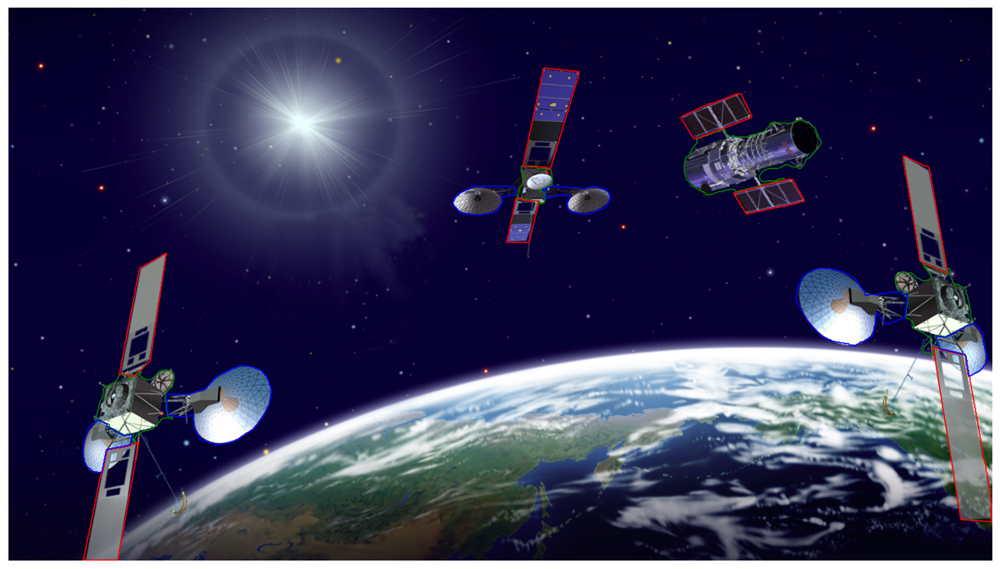

In [39]:
image = cv2.imread('Final_dataset/images/train/img_resize_1014.png')
draw_annotations(image, 'Final_dataset/annotations/train/img_resize_1014.txt')

### Сформируем аннотации к каждому изображению

In [40]:
train_mask_path = os.listdir('Final_dataset/mask/train')
val_mask_path = os.listdir('Final_dataset/mask/val')

In [41]:
for mask in train_mask_path:
    mask_to_annotation('Final_dataset/mask/train/' + mask)

In [42]:
for mask in val_mask_path:
    mask_to_annotation('Final_dataset/mask/val/' + mask)

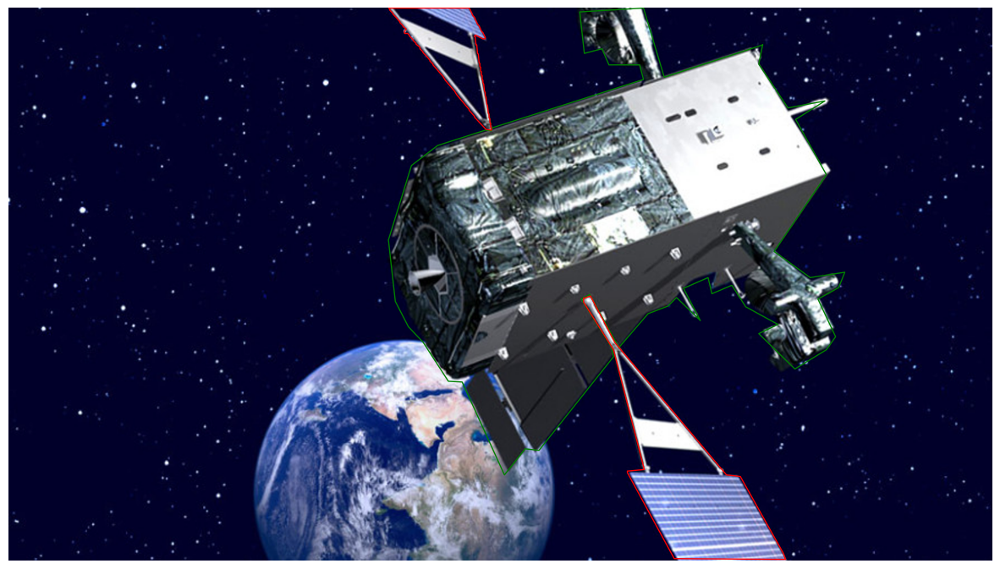

In [43]:
image = cv2.imread('Final_dataset/images/val/img_resize_784.png')
draw_annotations(image, 'Final_dataset/annotations/val/img_resize_784.txt')

## Обучение модели

In [ ]:
!yolo task=segment mode=train epochs=10 data=satellite_dataset.yaml model=yolov8s-seg.pt imgsz=640 batch=8

"""

Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:06<00:00,  6.24it/s]
                   all        600       2523      0.764      0.643      0.693      0.518      0.788      0.658      0.712      0.525
                  body        600        916      0.798      0.648      0.707       0.49      0.824      0.666      0.714      0.489
           solar_panel        600       1228      0.862      0.801      0.864      0.707      0.873      0.809       0.87      0.721
                antena        600        379      0.632       0.48      0.508      0.355      0.665      0.499      0.551      0.364

"""

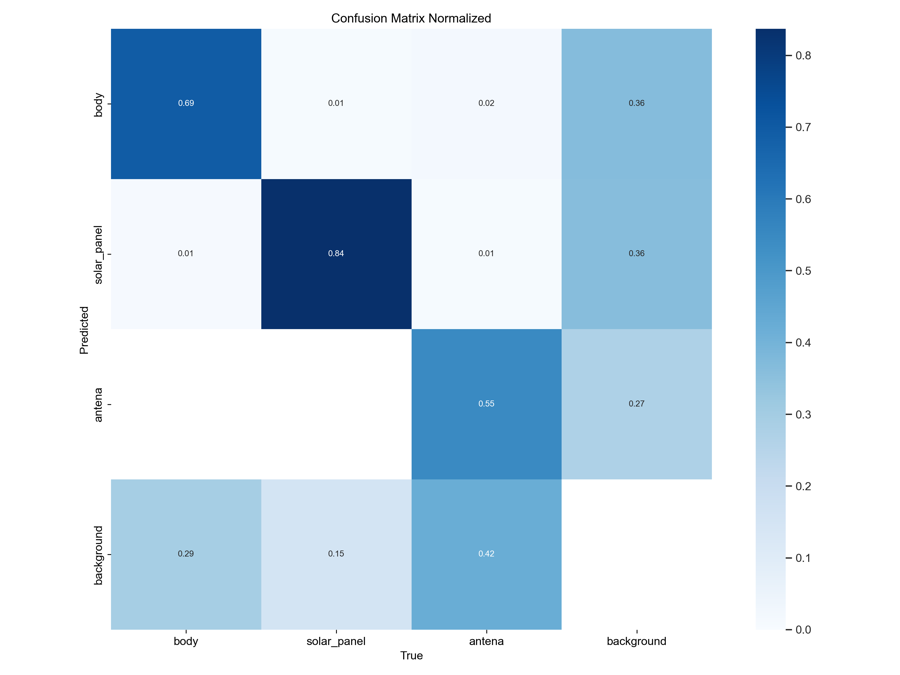

In [49]:
image = Image.open('runs/segment/train4/confusion_matrix_normalized.png')
scale = 0.3
new_width = int(image.width * scale)
new_height = int(image.height * scale)

# Изменяем размер изображения
resized_image = image.resize((new_width, new_height))

# Отображаем измененное изображение
display(resized_image)

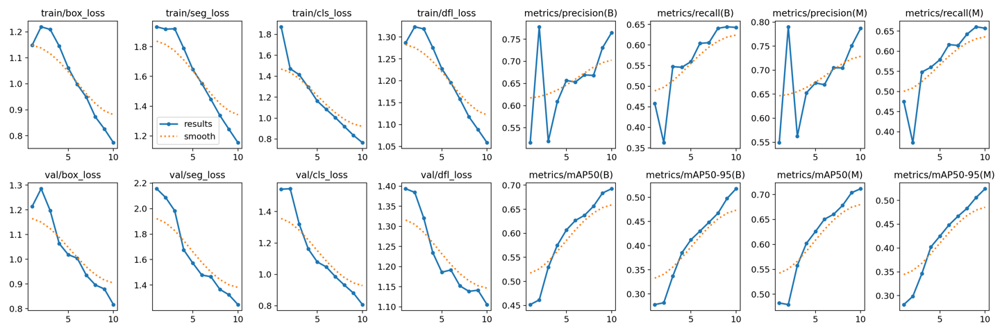

In [51]:
image = Image.open('runs/segment/train4/results.png')
scale = 0.4
new_width = int(image.width * scale)
new_height = int(image.height * scale)

# Изменяем размер изображения
resized_image = image.resize((new_width, new_height))

# Отображаем измененное изображение
display(resized_image)

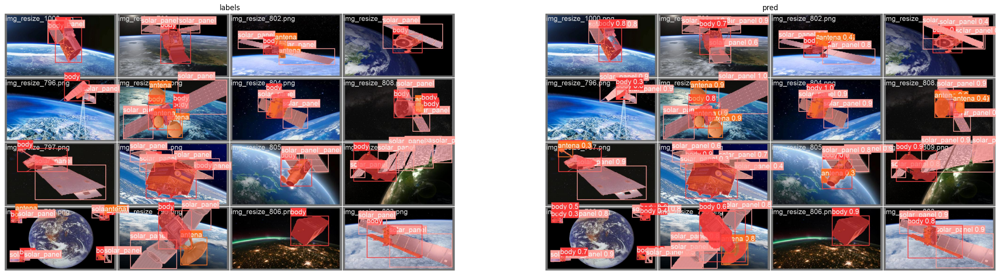

In [58]:
img1 = mpimg.imread('runs/segment/train4/val_batch0_labels.jpg')
img2 = mpimg.imread('runs/segment/train4/val_batch0_pred.jpg')

fig, ax = plt.subplots(1, 2, figsize=(30, 30))
ax[0].imshow(img1)
ax[0].axis('off')
ax[0].set_title('labels')

ax[1].imshow(img2)
ax[1].axis('off')
ax[1].set_title('pred')

plt.show()

Видим что модель отрабатывает не идеально, попробуем обучить её на большем количестве эпох.

In [19]:
!yolo task=segment mode=train epochs=100 data=satellite_dataset.yaml model=yolov8s-seg.pt imgsz=640 batch=8

Ultralytics YOLOv8.2.10 🚀 Python-3.12.3 torch-2.2.2+cu118 CUDA:0 (NVIDIA GeForce RTX 4060, 8187MiB)


train: Scanning C:\PythonProjects\2year\PROJECT-3\data\train\labels.cache... 2517 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2517/2517 [00:00<?, ?it/s]
train: Scanning C:\PythonProjects\2year\PROJECT-3\data\train\labels.cache... 2517 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2517/2517 [00:00<?, ?it/s]

val: Scanning C:\PythonProjects\2year\PROJECT-3\data\val\labels.cache... 600 images, 0 backgrounds, 0 corrupt: 100%|██████████| 600/600 [00:00<?, ?it/s]
val: Scanning C:\PythonProjects\2year\PROJECT-3\data\val\labels.cache... 600 images, 0 backgrounds, 0 corrupt: 100%|██████████| 600/600 [00:00<?, ?it/s]

  0%|          | 0/315 [00:00<?, ?it/s]
      1/100         3G      1.506      2.831      3.619      1.526         59        640:   0%|          | 0/315 [00:01<?, ?it/s]
      1/100         3G      1.506      2.831      3.619      1.526         59        640:   0%|          | 1/315 [00:01<07:26,  1.42s/it]
      1/100         3G      1.341      2.676      3.641      1.

'\n\n                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:08<00:00,  4.52it/s]\n                   all        600       2523      0.824      0.692      0.754      0.574      0.835      0.701      0.759      0.575\n                  body        600        916      0.846      0.691       0.74      0.532      0.866      0.707      0.747      0.528\n           solar_panel        600       1228      0.889      0.818      0.878      0.736      0.899      0.827      0.886      0.746\n                antena        600        379      0.737      0.567      0.646      0.453      0.741       0.57      0.645      0.452\n\n'


     47/100       2.9G     0.6386     0.9661     0.5283     0.9544         49        640:  31%|███       | 97/315 [00:16<00:39,  5.53it/s]
     47/100       2.9G     0.6386     0.9661     0.5283     0.9544         49        640:  31%|███       | 98/315 [00:16<00:38,  5.56it/s]
     47/100       2.9G     0.6392     0.9646     0.5283     0.9551         60        640:  31%|███       | 98/315 [00:16<00:38,  5.56it/s]
     47/100       2.9G     0.6392     0.9646     0.5283     0.9551         60        640:  31%|███▏      | 99/315 [00:16<00:38,  5.58it/s]
     47/100       2.9G     0.6392     0.9637     0.5279      0.955         54        640:  31%|███▏      | 99/315 [00:16<00:38,  5.58it/s]
     47/100       2.9G     0.6392     0.9637     0.5279      0.955         54        640:  32%|███▏      | 100/315 [00:16<00:38,  5.62it/s]
     47/100       2.9G     0.6386     0.9614     0.5271     0.9544         48        640:  32%|███▏      | 100/315 [00:16<00:38,  5.62it/s]
     47/100       2.9G  


engine\trainer: task=segment, mode=train, model=yolov8s-seg.pt, data=satellite_dataset.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train7, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, format=torchscript, keras=False, optimize=False, int8=F

### Результаты обучения модели

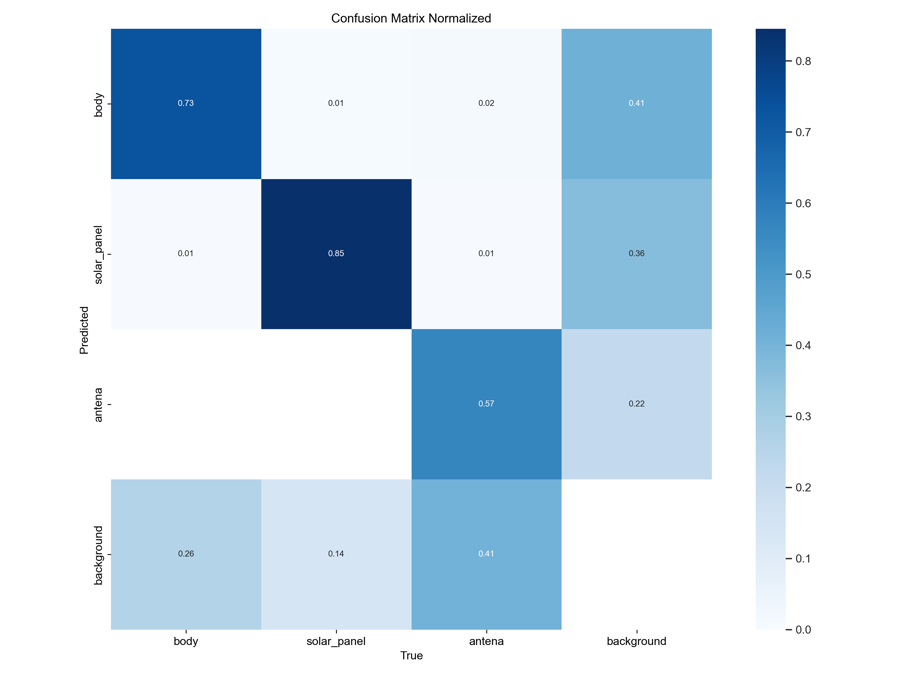

In [20]:
image = Image.open('runs/segment/train7/confusion_matrix_normalized.png')
scale = 0.3
new_width = int(image.width * scale)
new_height = int(image.height * scale)

# Изменяем размер изображения
resized_image = image.resize((new_width, new_height))

# Отображаем измененное изображение
display(resized_image)

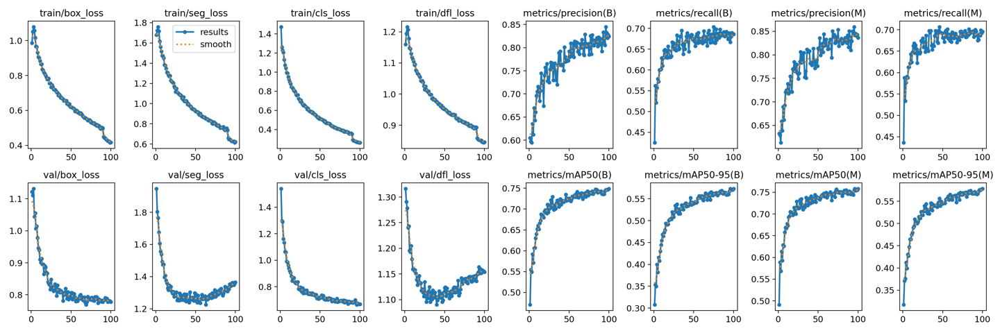

In [21]:
image = Image.open('runs/segment/train7/results.png')
scale = 0.4
new_width = int(image.width * scale)
new_height = int(image.height * scale)

# Изменяем размер изображения
resized_image = image.resize((new_width, new_height))

# Отображаем измененное изображение
display(resized_image)

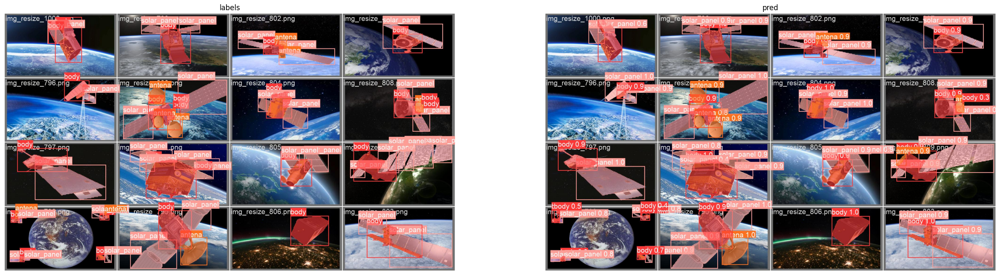

In [22]:
img1 = mpimg.imread('runs/segment/train7/val_batch0_labels.jpg')
img2 = mpimg.imread('runs/segment/train7/val_batch0_pred.jpg')

fig, ax = plt.subplots(1, 2, figsize=(30, 30))
ax[0].imshow(img1)
ax[0].axis('off')
ax[0].set_title('labels')

ax[1].imshow(img2)
ax[1].axis('off')
ax[1].set_title('pred')

plt.show()

### Тестирование модели

In [23]:
from ultralytics import YOLO
model = YOLO('runs/segment/train7/weights/best.pt')

In [24]:
model.predict(source='Copernicus_NTR_LEO.2k.jpg', show=True, save=True, show_labels=True, show_conf=True, conf=0.5, save_txt=True, save_crop=False, line_width=2)


image 1/1 c:\PythonProjects\2year\PROJECT-3\Copernicus_NTR_LEO.2k.jpg: 384x640 2 solar_panels, 1 antena, 10.0ms
Speed: 2.0ms preprocess, 10.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\segment\predict5
1 label saved to runs\segment\predict5\labels


[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: ultralytics.engine.results.Masks object
 names: {0: 'body', 1: 'solar_panel', 2: 'antena'}
 obb: None
 orig_img: array([[[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],
 
        ...,
 
        [[204, 202, 192],
         [196, 193, 185],
         [184, 181, 173],
         ...,
         [104,  93,  89],
         [105,  94,  90],
         [106,  95,  91]],
 
        [[198, 196, 186],
         [188, 185, 

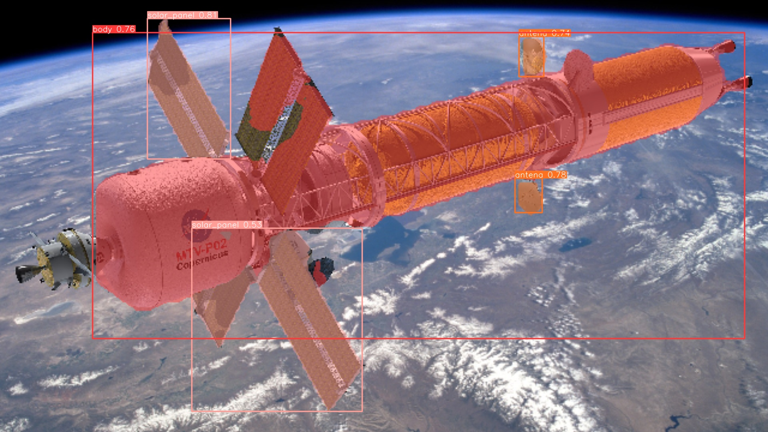

In [25]:
image = Image.open('runs/segment/predict2/Copernicus_NTR_LEO.2k.jpg')
scale = 0.4
new_width = int(image.width * scale)
new_height = int(image.height * scale)

# Изменяем размер изображения
resized_image = image.resize((new_width, new_height))

# Отображаем измененное изображение
display(resized_image)

In [26]:
# Путь к папке val
val_path = 'data/val/images'

# Отключить отображение предсказаний
model.show = False

# Пройтись по всем изображениям в папке val
for filename in os.listdir(val_path):
    if filename.endswith(".png"):
        # Получить путь к изображению
        img_path = os.path.join(val_path, filename)
        # Сохранить предсказания в формате txt
        model.predict(source=img_path, save_txt=True)


image 1/1 c:\PythonProjects\2year\PROJECT-3\data\val\images\img_resize_1000.png: 384x640 1 body, 2 solar_panels, 118.0ms
Speed: 4.0ms preprocess, 118.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\segment\predict5
2 labels saved to runs\segment\predict5\labels

image 1/1 c:\PythonProjects\2year\PROJECT-3\data\val\images\img_resize_1001.png: 384x640 1 body, 1 solar_panel, 8.0ms
Speed: 1.0ms preprocess, 8.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\segment\predict5
3 labels saved to runs\segment\predict5\labels

image 1/1 c:\PythonProjects\2year\PROJECT-3\data\val\images\img_resize_1002.png: 384x640 1 body, 2 solar_panels, 7.0ms
Speed: 1.0ms preprocess, 7.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\segment\predict5
4 labels saved to runs\segment\predict5\labels

image 1/1 c:\PythonProjects\2year\PROJECT-3\data\val\images\img_resize_403.png: 384x640 1 

## mIoU

In [133]:
def txt_to_mask(txt_file, img_size, num_classes):
    with open(txt_file, 'r') as f:
        lines = f.readlines()
    mask = np.zeros(img_size + (num_classes,), dtype=np.uint8)
    for line in lines:
        values = list(map(float, line.strip().split()))
        class_id = int(values[0])
        points = values[1:]
        points = np.array(points).reshape(-1, 2)
        points = np.rint(points * img_size[:2][::-1]).astype(np.int32)
        points = np.concatenate([points, [points[0]]], axis=0)
        mask_single = np.zeros(img_size[:2], dtype=np.uint8)
        cv2.fillConvexPoly(mask_single, points, 1)
        mask[:, :, class_id] = np.maximum(mask[:, :, class_id], mask_single)
    return mask

def calculate_iou(gt_mask, pred_mask):
    gt_mask = gt_mask.astype(bool)
    pred_mask = pred_mask.astype(bool)
    intersection = np.logical_and(gt_mask, pred_mask)
    union = np.logical_or(gt_mask, pred_mask)
    if np.sum(union) == 0:
        return 0
    else:
        return np.sum(intersection) / np.sum(union)

def calculate_miou_for_folder(gt_folder, pred_folder, img_size, num_classes):
    gt_files = os.listdir(gt_folder)
    gt_files = [f for f in gt_files if f.endswith('.txt')]
    pred_files = os.listdir(pred_folder)
    pred_files = [f for f in pred_files if f.endswith('.txt')]

    gt_masks = []
    pred_masks = []

    for gt_file, pred_file in zip(gt_files, pred_files):
        gt_path = os.path.join(gt_folder, gt_file)
        pred_path = os.path.join(pred_folder, pred_file)
        gt_mask = txt_to_mask(gt_path, img_size, num_classes)
        pred_mask = txt_to_mask(pred_path, img_size, num_classes)
        gt_masks.append(gt_mask)
        pred_masks.append(pred_mask)

    gt_masks = np.concatenate(gt_masks, axis=0)
    pred_masks = np.concatenate(pred_masks, axis=0)

    miou = calculate_iou(gt_masks, pred_masks)
    return miou

gt_folder = 'data/val/labels'
pred_folder = 'runs/segment/predict5/labels'
img_size = (640, 640)
num_classes = 3

miou = calculate_miou_for_folder(gt_folder, pred_folder, img_size, num_classes)
print('mIoU:', miou)

mIoU: 0.7966044459386122


### Посмотрим в каких случаях mIoU низкий

In [143]:
mask_iou = {
    'gt_txt':{},
    'pred_txt':{},
    'iou':{}
}

mask_iou = pd.DataFrame(mask_iou)

def calculate_iou_df(gt_folder, pred_folder, img_size, num_classes):
    gt_files = sorted(os.listdir(gt_folder))
    gt_files = [f for f in gt_files if f.endswith('.txt')]
    pred_files = sorted(os.listdir(pred_folder))
    pred_files = [f for f in pred_files if f.endswith('.txt')]

    gt_masks = []
    pred_masks = []

    for gt_file, pred_file in zip(gt_files, pred_files):
        gt_path = os.path.join(gt_folder, gt_file)
        pred_path = os.path.join(pred_folder, pred_file)
        gt_mask = txt_to_mask(gt_path, img_size, num_classes)
        pred_mask = txt_to_mask(pred_path, img_size, num_classes)
        mask_iou.loc[len(mask_iou.index)] = [gt_file, pred_file, calculate_iou(gt_mask, pred_mask)]

    return mask_iou

In [144]:
mask_iou = calculate_iou_df(gt_folder, pred_folder, img_size, num_classes)
mask_iou['iou'].mean()

0.8125190813303095

In [146]:
mask_iou.sort_values('iou').head()

,gt_txt,pred_txt,iou
300,img_resize_700.txt,img_resize_700.txt,0.000000
415,img_resize_815.txt,img_resize_815.txt,0.012090
276,img_resize_676.txt,img_resize_676.txt,0.021605
419,img_resize_819.txt,img_resize_819.txt,0.036053
488,img_resize_888.txt,img_resize_888.txt,0.074333


In [134]:
pred_mask = txt_to_mask('runs/segment/predict5/labels/img_resize_700.txt', img_size, num_classes)
gt_mask = txt_to_mask('data/val/labels/img_resize_700.txt', img_size, num_classes)
calculate_iou(gt_mask, pred_mask)

0.0

In [135]:
def visualize_mask(mask, img_size):
    fig, ax = plt.subplots()
    ax.imshow(mask.sum(axis=-1).reshape(img_size[0], img_size[1]))
    plt.show()

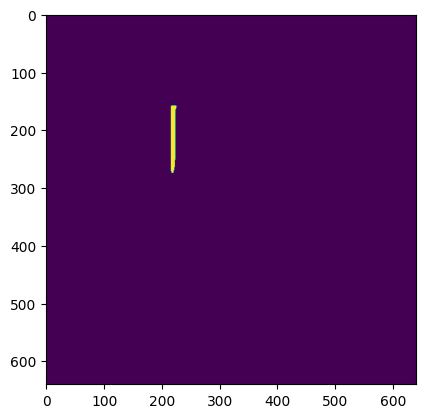

In [136]:
visualize_mask(pred_mask, img_size)

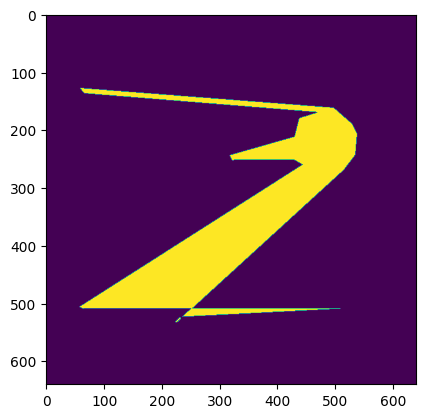

In [137]:
visualize_mask(gt_mask, img_size)

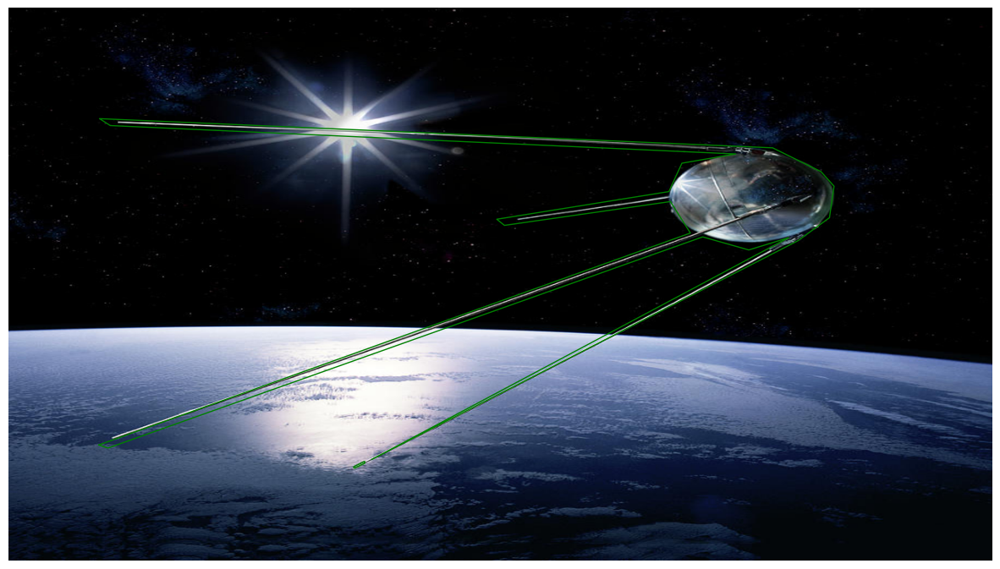

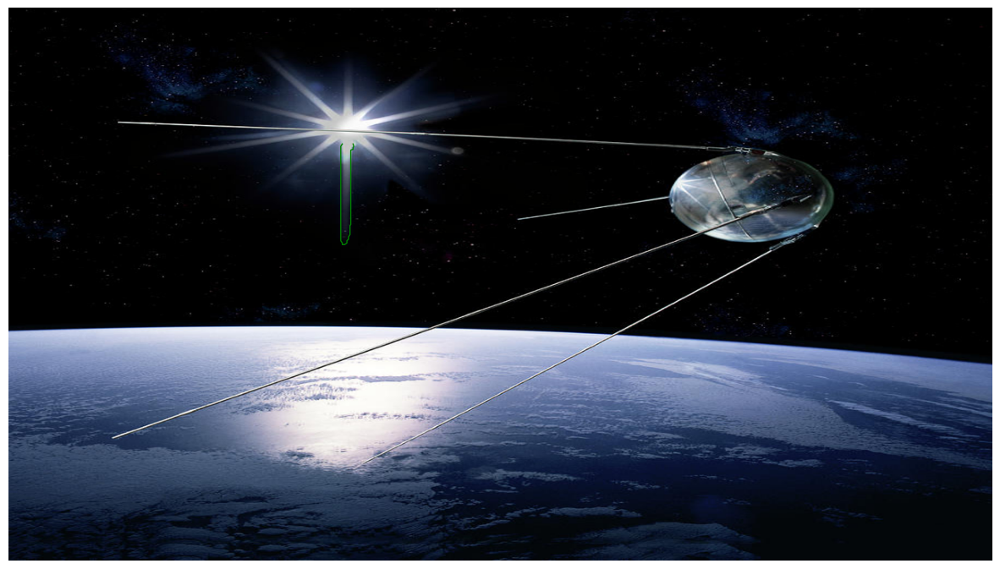

In [147]:
image = cv2.imread('data/val/images/img_resize_700.png')
draw_annotations(image, 'data/val/labels/img_resize_700.txt')
draw_annotations(image, 'runs/segment/predict5/labels/img_resize_700.txt')

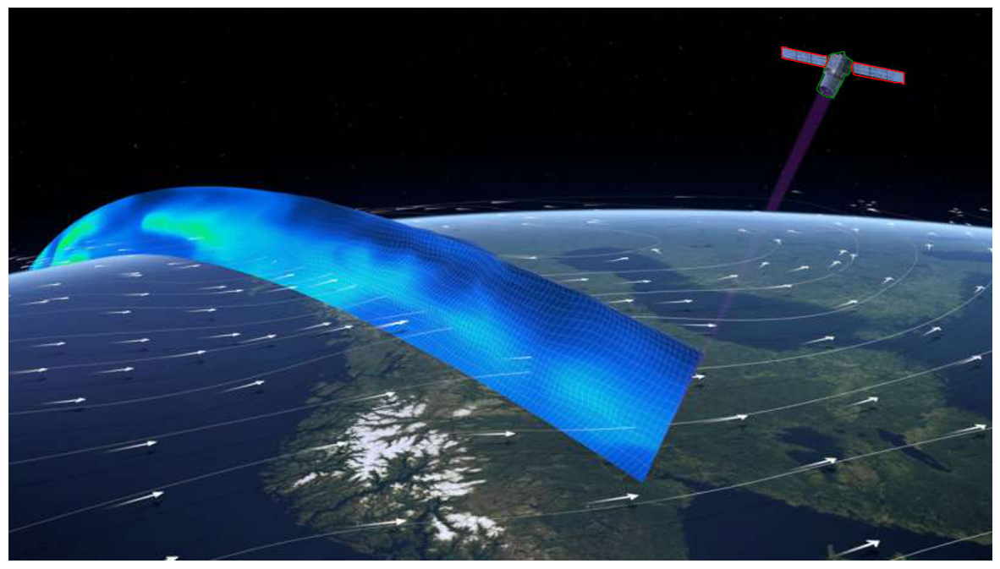

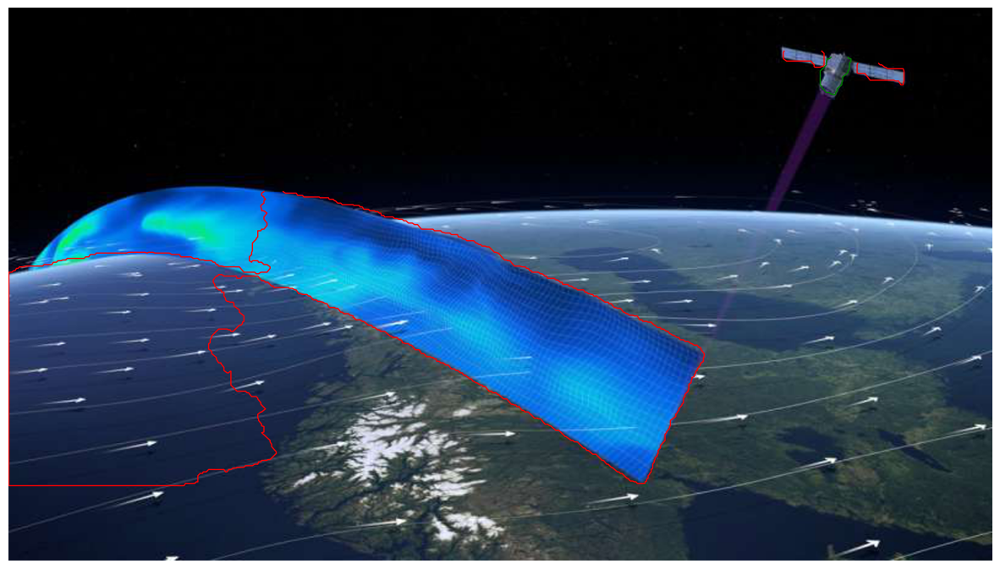

In [148]:
image = cv2.imread('data/val/images/img_resize_815.png')
draw_annotations(image, 'data/val/labels/img_resize_815.txt')
draw_annotations(image, 'runs/segment/predict5/labels/img_resize_815.txt')